In [1]:
#| default_exp wrapping_open3d

In [2]:
#| export

from blender_tissue_cartography import io as tcio
from blender_tissue_cartography import registration as tcreg
from blender_tissue_cartography import interface_open3d as into3d
import numpy as np
from copy import deepcopy
import open3d as o3d
import warnings

Jupyter environment detected. Enabling Open3D WebVisualizer.
[Open3D INFO] WebRTC GUI backend enabled.
[Open3D INFO] WebRTCWindowSystem: HTTP handshake server disabled.


In [3]:
from blender_tissue_cartography import interpolation as tcinterp
from skimage import transform
from scipy import stats, spatial, linalg
import os
import matplotlib.pyplot as plt
import mcubes

In [4]:
from tqdm.notebook import tqdm
from importlib import reload

In [5]:
np.set_printoptions(suppress=True)

## Automated wrapping

This notebook builds the tools for automated mesh wrapping (setting vertex positions of one mesh to the closest point on another mesh). This is a part of the pipeline for dynamic surfaces discussed in notebook 3a.

We have two separate notebooks  - and modules -  for wrapping, depending on whether we use `pymeshlab` or `open3d`. The reason for this is that `pymeshlab` may not be available on all platforms.

## Loading and segmenting the dataset

We will use the same dataset - a _Drosophila_ example - as in tutorial 2.

In [6]:
metadata_dict = {'filename': 'wrapping_example/Drosophila_CAAX-mCherry',
                 'resolution_in_microns': (1.05, 1.05, 1.05), # lightsheet data has isotropic resolution
                 'subsampling_factors': (1/2, 1/2, 1/2),
                }

In [7]:
image = tcio.adjust_axis_order(tcio.imread(f"{metadata_dict['filename']}.tif"))
print("image shape:", image.shape) # image shape - spatial axes are in z-x-y order

image shape: (1, 190, 509, 188)


## 3d segmentation / Meshing

Already done - we'll just read in the results.

## Registration

Using the tools from notebook 3a, compute an affine registration of the reference onto the data mesh.

In [8]:
mesh_data = tcio.ObjMesh.read_obj(f"{metadata_dict['filename']}_mesh_remeshed.obj")
mesh_ref = tcio.ObjMesh.read_obj(f"wrapping_example/Drosophila_reference.obj")

/home/nikolas/Documents/UCSB/streichan/numerics/code/python code/jupyter notebooks/blender-tissue-cartography/blender_tissue_cartography/io.py:202: RuntimeWarning: Warning: multiple meshes in .obj file
  warnings.warn(f"Warning: multiple meshes in .obj file", RuntimeWarning)


In [9]:
trafo_centroid_intertia, _ = tcreg.align_by_centroid_and_intertia(mesh_ref.vertices, mesh_data.vertices,
                                                                  q=0.01, shear=True)

trafo_icp, _, _ = tcreg.icp(mesh_ref.vertices, mesh_data.vertices, initial=trafo_centroid_intertia,
                            threshold=1e-4, max_iterations=100, scale=True, n_samples=5000)

In [10]:
# we now save the pre-registered mesh. Note that we want to transform both our
# mesh coordinates and the corresponding normals, as well as potentially flip face orientation

mesh_registered = mesh_ref.apply_affine_to_mesh(trafo_icp)
mesh_registered.name = "Drosophila_reference_preregistered"
mesh_registered.write_obj(f"wrapping_example/Drosophila_reference_registered.obj")

## Procedural wrapping

We can also automatically wrap using blender's python API. Let's see how it works. 
- `trimesh.proximity` appears not feasible - way too slow, 15s for 1k vertices.
- Annoyingly, blender scripts cannot be directly run from python. It must be done from within the blender script window. The goal here would be to write a script that can be either easily run in blender, or run from the command line (also possible via python's `shutil`).
- `open3d` is another option - see [here](https://www.open3d.org/docs/latest/tutorial/geometry/distance_queries.html). However, this adds another big dependency to the project.
- `pymeshlab`'s `transfer_attributes_per_vertex`

We will use the interfacing tools from notebooks 1b, 1c which allow us to convert our `ObjMesh` into `pymeshlab` or `open3d` classes.

### `open3d`

#### Smoothing

Smoothing both the target mesh and the wrapped mesh helps obtain smoother results. We presumably want to use the Taubin filter since it avoids mesh shrinkage, which would be bad for correspondence with image coordinates.

So far though I find that only the `filter_smooth_simple` (local vertex position averaging) really does anything. The Taubin filter appears to make things worse. It looks like it's maybe not correctly implemented (it gives different and better results in MeshLab).

In [13]:
reload(into3d); reload(tcio)

<module 'blender_tissue_cartography.io' from '/home/nikolas/Documents/UCSB/streichan/numerics/code/python code/jupyter notebooks/blender-tissue-cartography/blender_tissue_cartography/io.py'>

In [14]:
# Load source and target mesh
mesh_target = tcio.ObjMesh.read_obj("wrapping_example/Drosophila_CAAX-mCherry_mesh_remeshed.obj")
mesh_source = tcio.ObjMesh.read_obj("wrapping_example/Drosophila_reference_registered.obj")

In [15]:
mesh_target_o3d = into3d.convert_to_open3d(mesh_target)
mesh_source_o3d = into3d.convert_to_open3d(mesh_source)
mesh_source_wrapped_o3d = deepcopy(mesh_source_o3d)

In [16]:
mesh_target_o3d = o3d.t.geometry.TriangleMesh.from_legacy(
    mesh_target_o3d.to_legacy().filter_smooth_simple(number_of_iterations=1))

In [92]:
o3d.visualization.draw_plotly([mesh_target_o3d.to_legacy()])


In [93]:
# create a raycasting scene and compute the closest point on the surface of the target mesh.
scene = o3d.t.geometry.RaycastingScene()
_ = scene.add_triangles(mesh_target_o3d)
query_points = mesh_source_o3d.vertex.positions.numpy()
closest_points = scene.compute_closest_points(o3d.core.Tensor(query_points, dtype=o3d.core.Dtype.Float32))["points"]
# wrap mesh by setting vertex positions to closes ones on the target mesh
mesh_source_wrapped_o3d.vertex.positions = closest_points
mesh_source_wrapped_o3d.compute_vertex_normals()
mesh_source_wrapped_o3d = mesh_source_wrapped_o3d.to_legacy()

After wrapping, it makes sense to smooth the mesh a little: https://www.open3d.org/docs/latest/tutorial/geometry/mesh.html. Need to convert to legacy interface for filters...

In [94]:
o3d.visualization.draw_plotly([mesh_source_wrapped_o3d])


In [ ]:
mesh_source_wrapped_filtered_o3d = mesh_source_wrapped_o3d.filter_smooth_simple(number_of_iterations=2)
mesh_source_wrapped_filtered_o3d.triangle_uvs = mesh_source_wrapped_o3d.triangle_uvs

In [ ]:
o3d.visualization.draw_plotly([mesh_source_wrapped_filtered_o3d])

In [98]:
mesh_wrapped_o3d = into3d.convert_from_open3d(mesh_source_wrapped_filtered_o3d)

In [99]:
mesh_wrapped_o3d.write_obj("wrapping_example/Drosophila_reference_wrapped_o3d.obj")

#### Package into function

In [17]:
#| export

def shrinkwrap_o3d(mesh_source, mesh_target, n_iter_smooth_target=1, n_iter_smooth_wrapped=1):
    """
    Shrink-wrap the source mesh onto the target mesh using open3d.
    
    Sets the vertex positions of mesh_source to the closes point on the surface of mesh_target (not necessarily
    a vertex). Optionally, smoothes the target mesh and the wrapped mesh for smoother results using a
    simple smoothing filter filter (recommended). Gives out a warning if the shrink-wrapping flips
    any vertex normals, which can indicate problems.
    
    The shrinkwrapped mesh still has the UV maps of the source mesh, and so can be used to compute
    cartographic projections.
    
    Parameters
    ----------
    mesh_source : tcio.ObjMesh
        Mesh to be deformed
    mesh_target : tcio.ObjMesh
        Mesh with target shape
    n_iter_smooth_target : int, default 1
        Smoothing iterations for target. Setting this value too high will result in "shrinkage",
        and the mesh won't match your image data well anymore.
    n_iter_smooth_wrapped : int, default 1
        Smoothing iterations for shrinkwrapped mesh, after shrinkwrapping. Setting this value
        too high will result in "shrinkage",  and the mesh won't match your image data well anymore.

    Returns
    -------
    mesh_wrapped : tcio.ObjMesh

    """
    warnings.warn('This method is deprecated. Use wrapping.shrinkwrap_igl', DeprecationWarning, stacklevel=2)
    mesh_target_o3d = into3d.convert_to_open3d(mesh_target)
    mesh_source_o3d = into3d.convert_to_open3d(mesh_source)
    mesh_source_wrapped_o3d = deepcopy(mesh_source_o3d)
    # smooth - have to convert to `legacy` representation
    mesh_target_o3d = o3d.t.geometry.TriangleMesh.from_legacy(
        mesh_target_o3d.to_legacy().filter_smooth_simple(number_of_iterations=n_iter_smooth_target))
    # create a raycasting scene and compute the closest point on the surface of the target mesh.
    scene = o3d.t.geometry.RaycastingScene()
    _ = scene.add_triangles(mesh_target_o3d)
    query_points = mesh_source_o3d.vertex.positions.numpy()
    closest_points = scene.compute_closest_points(o3d.core.Tensor(query_points,
                                                                  dtype=o3d.core.Dtype.Float32))["points"]
    # wrap mesh by setting vertex positions to closes ones on the target mesh
    mesh_source_wrapped_o3d.vertex.positions = closest_points
    mesh_source_wrapped_o3d.compute_vertex_normals()
    mesh_source_wrapped_o3d = mesh_source_wrapped_o3d.to_legacy()
    mesh_source_wrapped_filtered_o3d = mesh_source_wrapped_o3d.filter_smooth_simple(
        number_of_iterations=n_iter_smooth_wrapped)
    mesh_source_wrapped_filtered_o3d.triangle_uvs = mesh_source_wrapped_o3d.triangle_uvs
    mesh_wrapped = into3d.convert_from_open3d(mesh_source_wrapped_filtered_o3d)
    # check if any normals were flipped
    dots = np.einsum("vi,vi->v", mesh_source.normals, mesh_wrapped.normals)
    if np.sum(dots < 0) > 0:
        warnings.warn(f"Warning: {np.sum(dots<0)} normal(s) flipped during shrink-wrapping")
    return mesh_wrapped

In [18]:
# Load source and target mesh
mesh_target = tcio.ObjMesh.read_obj("wrapping_example/Drosophila_CAAX-mCherry_mesh_remeshed.obj")
mesh_source = tcio.ObjMesh.read_obj("wrapping_example/Drosophila_reference_registered.obj")

In [19]:
mesh_wrapped_03d = shrinkwrap_o3d(mesh_source, mesh_target,
                                  n_iter_smooth_target=1, n_iter_smooth_wrapped=2)

In [106]:
mesh_wrapped_03d.write_obj("wrapping_example/Drosophila_reference_wrapped_o3d.obj")

#### Test I/O speed

Writing is already almost as fast as `open3d` - no further improvement likely.

In [72]:
%%timeit
o3d.io.write_triangle_mesh("registration_example/Drosophila_reference_wrapped_o3d.obj", mesh_source_o3d.to_legacy())

[Open3D WARNING] Write OBJ can not include triangle normals.
[Open3D WARNING] Write OBJ can not include triangle normals.
[Open3D WARNING] Write OBJ can not include triangle normals.
[Open3D WARNING] Write OBJ can not include triangle normals.
[Open3D WARNING] Write OBJ can not include triangle normals.
[Open3D WARNING] Write OBJ can not include triangle normals.
[Open3D WARNING] Write OBJ can not include triangle normals.
[Open3D WARNING] Write OBJ can not include triangle normals.
1.98 s ± 57.6 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


In [73]:
%%timeit
mesh_source_wrapped.write_obj("registration_example/Drosophila_reference_wrapped_o3d.obj")

1.68 s ± 16.4 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


In [74]:
%%timeit
_ = o3d.t.geometry.TriangleMesh.from_legacy(
    o3d.io.read_triangle_mesh("registration_example/Drosophila_reference_wrapped_o3d.obj"))

141 ms ± 3.3 ms per loop (mean ± std. dev. of 7 runs, 10 loops each)


In [75]:
%%timeit
tcio.ObjMesh.read_obj("registration_example/Drosophila_reference_wrapped_o3d.obj")

554 ms ± 5.1 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


## UV projection

To see how well all of this has worked, let's use the wrapped mesh to generate UV projections.

In [20]:
normal_offsets = np.array([-4, -2, 0, 2]) ##np.linspace(-5, 2, 8) # in microns
metadata_dict["normal_offsets"] = normal_offsets # add the info to the metadata
uv_grid_steps = 512

In [21]:
tcio.save_dict_to_json(f"{metadata_dict['filename']}_metadata.json", metadata_dict)

In [22]:
projected_data_wrapped, projected_coordinates_wrapped, projected_normals_wrapped = tcinterp.create_cartographic_projections(
    image=f"{metadata_dict['filename']}.tif",
    mesh=f"wrapping_example/Drosophila_reference_wrapped_o3d.obj",
    resolution=metadata_dict["resolution_in_microns"],
    normal_offsets=normal_offsets,
    uv_grid_steps=uv_grid_steps)

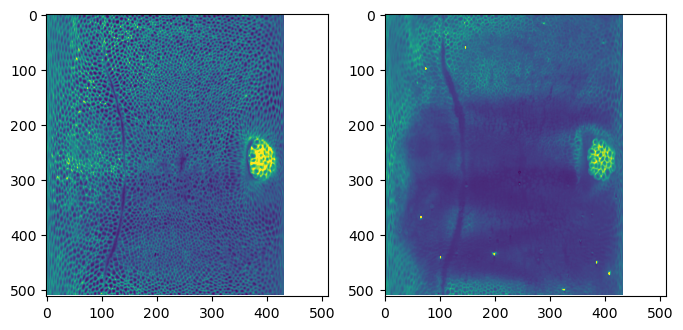

In [23]:
# show the projected data - looks good!

fig, (ax1, ax2) = plt.subplots(figsize=(8,8), ncols=2)
ax1.imshow(projected_data_wrapped[0, 0], vmax=10000)
ax2.imshow(projected_data_wrapped[0, 2], vmax=10000)